# Text Classification:

## Data
<pre>
1. we have total of 20 types of documents(Text files) and total 18828 documents(text files).
2. You can download data from this <a href='https://drive.google.com/open?id=1rxD15nyeIPIAZ-J2VYPrDRZI66-TBWvM'>link</a>, in that you will get documents.rar folder. <br>If you unzip that, you will get total of 18828 documnets. document name is defined as'ClassLabel_DocumentNumberInThatLabel'. 
so from document name, you can extract the label for that document.
4. Now our problem is to classify all the documents into any one of the class.
5. Below we provided count plot of all the labels in our data. 
</pre>

<IPython.core.display.Javascript object>


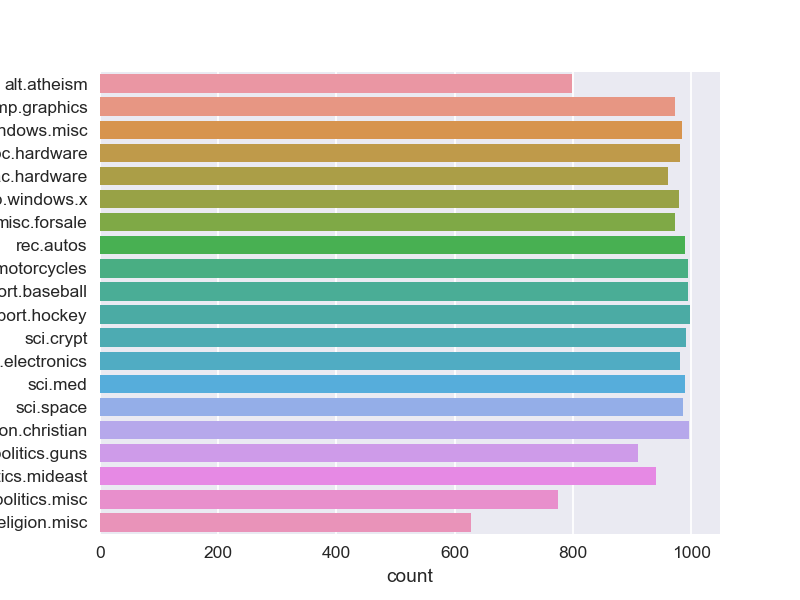

In [ ]:
### count plot of all the class labels. 

## Assignment:

#### sample document
<pre>
<font color='blue'>
Subject: A word of advice
From: jcopelan@nyx.cs.du.edu (The One and Only)

In article < 65882@mimsy.umd.edu > mangoe@cs.umd.edu (Charley Wingate) writes:
>
>I've said 100 times that there is no "alternative" that should think you
>might have caught on by now.  And there is no "alternative", but the point
>is, "rationality" isn't an alternative either.  The problems of metaphysical
>and religious knowledge are unsolvable-- or I should say, humans cannot
>solve them.

How does that saying go: Those who say it can't be done shouldn't interrupt
those who are doing it.

Jim
--
Have you washed your brain today?
</font>
</pre>

In [ ]:
len(preprocessed_email)

18828

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
import os
os.chdir("/content/gdrive/MyDrive/Colab Notebooks/CNN_text_class")

### ***1.Function for preprocessing email***

In [ ]:
import re

In [ ]:
#replaces email with space in the text and return it
def replacemail(aa):
  nomail=re.findall(r"([\w.]+@[\w.]+[com|net|edu])",aa)
  for i in range(0,len(nomail)):
    aa=re.sub(nomail[i]," ",aa)
  return aa

In [ ]:
#preprocess each emails in text into given format and return all emails after concatening them into one single string
def preprocessemail(aa):
  bb=re.findall(r"[\w.]+@([\w.]+[com|net|edu])",aa,re.IGNORECASE)
  #print(bb)
  c,e=[],[]
  final=[]
  if len(bb)>0:
    for i in range(0,len(bb)):
      a=list(bb[i])
      b=a[0]
      d=b.split('.')
      for j in range(0,len(d)):
        if(len(d[j])>2 and d[j]!='com'):
          e.append(d[j])
      c.append(b)
    finall=e[0]
    for i in range(1,len(e)):
      finall=finall+" "+e[i]
    final.append(finall)
    return final[0]
  else:
    return 'NA'

In [ ]:
def preprocessemail1(aa):
  bb=re.findall(r"[\w.]+@([\w.]+[com|net|edu])",aa,re.IGNORECASE)
  #print(bb)
  c=[]
  final=""
  if (len(bb)>0):
    for i in range(0,len(bb)):
      wrd=bb[i].split(".")
      #print(wrd)
      for j in range(0,len(wrd)-1):
        #print(j)
        if j==0 and i==0:
          final=final+wrd[j]
        else:
          if (wrd[j] not in c):
            final=final+" "+wrd[j]
        c.append(wrd[j])
    return final
  else:
    return "NA"  

### ***2.Function for preprocessing subject***

In [ ]:
#This function is used to replace all the subject sentence with space and return the text
def replacesubject(aa):
  sub=re.findall(r"[\w.]*Subject:.*",aa,re.IGNORECASE)
  nosub=aa
  for i in range(0,len(sub)):
    nosub=re.sub(sub[i],"",nosub,re.IGNORECASE)
  return nosub

In [ ]:
def replacesubject1(aa):
  sub=re.findall(r"[\w.]*Subject:.*",aa,re.IGNORECASE)
  nosub=aa
  for i in range(0,len(sub)):
    nosub=nosub.replace(sub[i],"")
  return nosub

In [ ]:
#This function is used to do preprocessing for each subject in text and return the preprocessed subject after concatenation
def preprocesSubject(aa):
  sub=re.findall(r"[\w.]*Subject:(.*)",aa,re.IGNORECASE)
  sub1=[]
  if (len(sub)>0):
    for i in range(0,len(sub)):
      if ':' in sub[i]:
        aind=sub[i]
        ind=sub[i].rindex(":")
        sub1.append(aind[ind+1:])
      else:
        sub1.append(sub[i])
    final_subject=""
    for i in range(0,len(sub1)):
      v=re.findall(r"\s+",sub1[i])
      if(len(v)>0):
        for j in range(0,len(v)):
          stri=sub1[i].replace(v[j]," ")
        u=re.findall(r"[\w]+",stri)
        final_sub=""
        if len(u)>0:
          for j in range(0,len(u)):
            if j==0:
              final_sub=final_sub+u[j]
            else:
              final_sub=final_sub+" "+u[j]
          final_subject=final_subject+" "+final_sub
      else:
        final_subject=final_subject+" "+sub1[i]
    return final_subject
  else:
    return 'NA'

### ***3.Function for preprocessing From: and Write to:***

In [ ]:
#This function returns text after removing sentences starting with from: or write to:
def replacefromwriteto(aa):
  nofromwrite=aa
  nofrom=re.findall(r"From:.*",aa,re.IGNORECASE)
  nofromwrite=re.sub("From:.*","",nofromwrite,re.IGNORECASE)
  #nofromwrite=re.findall(r"^[\s]*?Write to:.*",aa,re.IGNORECASE)
  nofw=re.findall(r"write to:.*",nofromwrite,re.IGNORECASE)
  for i in range(0,len(nofw)):
    nofromwrite=re.sub(nofw[i],"",nofromwrite,re.IGNORECASE)
  return nofromwrite

### ***4.Function for preprocessing tags(<>)***

In [ ]:
def replacetags(aa):
  notags=re.sub(r"<.*>","",aa,re.IGNORECASE)
  return notags

### ***5.Function for preprocessing brackets()***



In [ ]:
def replacebrackets(aa):
  nobrackets=re.sub(r"[(][^\d]+[)]","",aa,re.IGNORECASE)
  return nobrackets

### ***6.Function for removing \n,\t,-,\***

In [ ]:
def replacenewlinechars(aa):
  noextrachars=re.sub(r"\\n|\\t|-|\\","",aa,re.IGNORECASE)
  return noextrachars

### ***Function for removingcolonword:***

In [ ]:
def removecolonword(text):
  text=re.sub(r"[a-zA-Z]+:","",text)
  return text

### ***7. Function for decontracting words(i 've->i have)***

In [ ]:
def decontracted(phrase):
    # general
    phrase = re.sub(r"n\'t", " not", phrase)
    phrase = re.sub(r"\'re", " are", phrase)
    phrase = re.sub(r"\'s", " is", phrase)
    phrase = re.sub(r"\'d", " would", phrase)
    phrase = re.sub(r"\'ll", " will", phrase)
    phrase = re.sub(r"\'t", " not", phrase)
    phrase = re.sub(r"\'ve", " have", phrase)
    phrase = re.sub(r"\'m", " am", phrase)
    return phrase

In [ ]:
#importing nltk packages required for chunking
import nltk
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('maxent_ne_chunker')
nltk.download('words')

### ***8. Function for Chunking and replacing***

In [ ]:
#Half code is taken from stackoverflow reference given in this notebook
from nltk import ne_chunk, pos_tag, word_tokenize
from nltk.tree import Tree
def chunking(text):
  chunked = ne_chunk(pos_tag(word_tokenize(text)))
  continuous_chunk = []
  current_chunk = []
  labels=[]
  for i in chunked:
   if type(i) == Tree:
    #labels.append(i.label())
    current_chunk.append(" ".join([token for token, pos in i.leaves()]))
    #print(current_chunk)
   if current_chunk:
    named_entity = " ".join(current_chunk)
    #print(named_entity)
    if named_entity not in continuous_chunk:
      labels.append(i.label())
      continuous_chunk.append(named_entity)
      current_chunk = []
   else:
    continue
  #print(continuous_chunk)
  #print(labels)
  if(len(labels)==len(continuous_chunk)):
    for i in range(0,len(labels)):
      if labels[i]=="PERSON":
        text = text.replace(continuous_chunk[i],"")
        #print(text)
      elif (" " in continuous_chunk[i] and labels[i]!="PERSON"):
        #print(text)
        txt=continuous_chunk[i].split(" ")
        #print(txt)
        txt1=txt[0]
        for j in range(1,len(txt)):
          txt1=txt1+"_"+txt[j]
        #print(txt1)
        #print(continuous_chunk[i])
        text=text.replace(continuous_chunk[i],txt1)
        #print(text)
      else:
        continue
  return text

### ***9. Function for replacing digit***

In [ ]:
def replacedigit(text):
  text=re.sub(r"\d","",text)
  return text

### ***10. Function for replacing \_words_:***

In [ ]:
#remove the _ from the words
def replacingunderscorewords(text):
  words=re.findall(r"([_]\w+[_]|[_]\w+|\w+[_])",text)
  wordcopy=words.copy()
  for i in range(0,len(words)):
    wordcopy[i]=wordcopy[i].replace("_","")
  for i in range(0,len(words)):
    text=re.sub(words[i],wordcopy[i],text,1)
  return text

### ***11. Function for replacing word:***

In [ ]:
#remove the words which are length less than or equal to 2 after spliiting those words by "_"
def replacingword(a2):
  words=re.findall(r"[a-zA-Z]+_[a-zA-Z]+",a2)
  for i in range(0,len(words)):
    split=words[i].split("_")
    if(len(split[0])<=2):
      a2=re.sub(words[i],split[1],a2)
  return a2

### ***12. Function for covertlowercase:***

In [ ]:
def tolowercaseonlywords(a2):
  words=re.findall(r"[a-zA-Z]+",a2)
  finalstring=""
  for i in range(0,len(words)):
    if ((len(words[i])<=2) | (len(words[i])>=15)):
      continue
    else:
      lowercase=words[i].lower()
      finalstring=finalstring+" "+lowercase
  return finalstring

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


### To get data frame --> Writing all Preprocessing steps in One Function Named Preprocess as below and get all preprocessed items and form dataframe

# ***Final function for preprocessing***

In [ ]:
#function for returning 5 coulumn values for our dataframe
def preprocess(Input_Text,nameoffile):
    """Do all the Preprocessing as shown above and
    return a tuple contain preprocess_email,preprocess_subject,preprocess_text for that Text_data"""
    print("Input:",Input_Text)
    print("#"*60)
    list_of_preproessed_emails1=preprocessemail1(Input_Text)
    list_of_preproessed_emails1=list_of_preproessed_emails1.lower()
    if len(list_of_preproessed_emails1)>0:
      submail=list_of_preproessed_emails1.split(" ")
      list_of_preproessed_emails=""
      for i in range(0,len(submail)):
        if len(submail[i])>2:
          list_of_preproessed_emails=list_of_preproessed_emails+" "+submail[i]
    else:
      list_of_preproessed_emails=list_of_preproessed_emails1
    text=replacemail(Input_Text)
    #print("email:")
    #print(text)
    #print("#"*60)
    subject1=preprocesSubject(text)
    subject1=subject1.lower()
    if len(subject1)>0:
      sublist=subject1.split(" ")
      subject=""
      for i in range(0,len(sublist)):
        if len(sublist[i])>2:
          subject=subject+" "+sublist[i]
    else:
      subject=subject1
    text=replacesubject1(text)
    #print("subject:")
    #print(text)
    #print("#"*60)
    text=replacefromwriteto(text)
    #print("fromwriteto:")
    #print(text)
    #print("#"*60)
    text=replacetags(text)
    #print("replacetags:")
    #print(text)
    #print("#"*60)
    text=replacebrackets(text)
    #print("replacebrackets:")
    #print(text)
    #print("#"*60)
    text=replacenewlinechars(text)
    #print("replacenewline:")
    #print(text)
    #print("#"*60)
    text=removecolonword(text)
    #print("removecolonword:")
    #print(text)
    #print("#"*60)
    text=decontracted(text)
    #print("decontract:")
    #print(text)
    #print("#"*60)
    text=chunking(text)
    #print("chunk:")
    #print(text)
    #print("#"*60)
    text=replacedigit(text)
    #print("replacedigit:")
    #print(text)
    #print("#"*60)
    text=replacingunderscorewords(text)
    #print("replaceunderscoreword:")
    #print(text)
    #print("#"*60)
    text=replacingword(text)
    #print("replaceword:")
    #print(text)
    #print("#"*60)
    text=tolowercaseonlywords(text)
    print("list of emails: ",list_of_preproessed_emails)
    print("#"*60)
    print("subject: ",subject)
    print("#"*60)
    print("text: ",text)
    print("#"*60)
    classname=getclassname(nameoffile)
    classname=classname.lower()
    print(classname)
    print("#"*60)
    return (Input_Text,classname,text,subject,list_of_preproessed_emails)

In [ ]:
#to get classname
def getclassname(filename):
  clas=filename.split("_")
  nameclass=clas[0]
  return nameclass

### After writing Preprocess function, call the function for each of the document(18828 docs) and then create a dataframe as mentioned above.

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
import os
filelist=os.listdir("/content/gdrive/MyDrive/Colab Notebooks/CNN_text_class")

In [ ]:
import os
os.chdir("/content/gdrive/MyDrive/Colab Notebooks/CNN_text_class")

In [ ]:
for i in filelist:
  print(i)

### ***Code check for preprocess***

In [ ]:
for i,j in enumerate(filelist):
  if j=="alt.atheism_49960.txt":
    fileobject=open(j,"r",errors='ignore')
    content=fileobject.read()
    preproc=preprocess(content,j)

Input: From: mathew <mathew@mantis.co.uk>
Subject: Alt.Atheism FAQ: Atheist Resources

Archive-name: atheism/resources
Alt-atheism-archive-name: resources
Last-modified: 11 December 1992
Version: 1.0

                              Atheist Resources

                      Addresses of Atheist Organizations

                                     USA

FREEDOM FROM RELIGION FOUNDATION

Darwin fish bumper stickers and assorted other atheist paraphernalia are
available from the Freedom From Religion Foundation in the US.

Write to:  FFRF, P.O. Box 750, Madison, WI 53701.
Telephone: (608) 256-8900

EVOLUTION DESIGNS

Evolution Designs sell the "Darwin fish".  It's a fish symbol, like the ones
Christians stick on their cars, but with feet and the word "Darwin" written
inside.  The deluxe moulded 3D plastic fish is $4.95 postpaid in the US.

Write to:  Evolution Designs, 7119 Laurel Canyon #4, North Hollywood,
           CA 91605.

People in the San Francisco Bay area can get Darwin Fish from Ly

In [ ]:
print(preproc)

("From: muellerm@vuse.vanderbilt.edu (Marc Mueller)\nSubject: Re: ABOLISH SELECTIVE SERVICE\n\nIn article <1993Apr16.131508.9518@ra.msstate.edu> fpa1@Trumpet.CC.MsState.Edu (Fletcher P Adams) writes:\n>kmitchel@netcom.com (Kenneth C. Mitchell) writes:\n>>Dave Borden (borden@head-cfa.harvard.edu) wrote:\n>>: The Selective Service Registration should be abolished.  To start with, the\n>>: draft is immoral.  Whether you agree with that or not, we don't have one now,\n>>: and military experts agree that the quality of the armed forces is superior\n>>: with a volunteer army than with draftees.  Finally, the government has us\n>>: on many lists in many computers (the IRS, Social Security Admistration and\n>>: Motor Vehicle Registries to name a few) and it can find us if it needs to.\n>>: Maintaining yet another list of people is an utter waste of money and time.\n>>: Let's axe this whole department, and reduce the deficit a little bit.\n>\n>I'm really surprised Clinton hasn't already tried t

In [ ]:
#creating dataframe
import pandas as pd
df=pd.DataFrame(datta1,columns = ['text', 'class','preprocessed_text','preprocessed_subject','preprocessed_emails'])
#df.columns

### ***Here in this code block we have preprocessed all files and stored them in pickle files at regular intervals***

In [ ]:
#list that holds row values to be added to dataframe
datalist=[]

In [ ]:
import pickle
for i,j in enumerate(filelist):
    print(i)
    fileobject=open(j,"r",errors='ignore')
    content=fileobject.read()
    preproc=preprocess(content,j)
    datalist.append(preproc)
    fileobject.close()
    if i==4999 or i==9999 or i==14999 or i==len(filelist)-1:
      a_pick=open(str(i)+".pickle","wb")
      pickle.dump(datalist,a_pick)
      a_pick.close()
      datalist=[]

### ***Using all the pickle files we have created our finaldataframe which is also stored in a pickle file for later use.***

In [ ]:
import pickle
pick=open("1finaldataframe.pickle","rb")
df=pickle.load(pick)

In [ ]:
df.head(5)

,text,class,preprocessed_text,preprocessed_subject,preprocessed_emails
0,From: muellerm@vuse.vanderbilt.edu (Marc Muell...,talk.politics.misc,article the political feasibility him abolish...,abolish selective service,vuse vanderbilt msstate trumpet msstate netcom
1,From: jmorriso@rflab.ee.ubc.ca (John Paul Morr...,talk.politics.misc,article more likely than most places when was...,why not concentrate,rflab ubc rigel tamu
2,From: mwalker@novell.com (Mel Walker)\nSubject...,talk.politics.misc,article top ten ways his standing with americ...,top ten ways slick willie could improve his s...,novell newsserver solomon
3,From: gld@cunixb.cc.columbia.edu (Gary L Dare)...,talk.politics.misc,ujsnyder msuvx there never any mention how mu...,one payer system,cunixb columbia mizzou1 missouri cunixc
4,From: stephen@orchid.UCSC.EDU ()\nSubject: New...,talk.politics.misc,article edu having lot sex with different par...,new guess out gay percentage,orchid ucsc murdoch acc virginia fermi clas


In [ ]:
#combining all the 3 columns to form a single column
df["preprocessed(text_subject_mail)"]=df["preprocessed_text"]+df['preprocessed_subject']+df['preprocessed_emails']

In [ ]:
df.head(5)

,text,class,preprocessed_text,preprocessed_subject,preprocessed_emails,preprocessed(text_subject_mail)
0,From: muellerm@vuse.vanderbilt.edu (Marc Muell...,talk.politics.misc,article the political feasibility him abolish...,abolish selective service,vuse vanderbilt msstate trumpet msstate netcom,article the political feasibility him abolish...
1,From: jmorriso@rflab.ee.ubc.ca (John Paul Morr...,talk.politics.misc,article more likely than most places when was...,why not concentrate,rflab ubc rigel tamu,article more likely than most places when was...
2,From: mwalker@novell.com (Mel Walker)\nSubject...,talk.politics.misc,article top ten ways his standing with americ...,top ten ways slick willie could improve his s...,novell newsserver solomon,article top ten ways his standing with americ...
3,From: gld@cunixb.cc.columbia.edu (Gary L Dare)...,talk.politics.misc,ujsnyder msuvx there never any mention how mu...,one payer system,cunixb columbia mizzou1 missouri cunixc,ujsnyder msuvx there never any mention how mu...
4,From: stephen@orchid.UCSC.EDU ()\nSubject: New...,talk.politics.misc,article edu having lot sex with different par...,new guess out gay percentage,orchid ucsc murdoch acc virginia fermi clas,article edu having lot sex with different par...


In [ ]:
#getting class labels
y=df['class']
df=df.drop(['class'],axis=1)

In [ ]:
y.head(5)

0    talk.politics.misc
1    talk.politics.misc
2    talk.politics.misc
3    talk.politics.misc
4    talk.politics.misc
Name: class, dtype: object

In [ ]:
df.head(5)

,text,preprocessed_text,preprocessed_subject,preprocessed_emails,preprocessed(text_subject_mail)
0,From: muellerm@vuse.vanderbilt.edu (Marc Muell...,article the political feasibility him abolish...,abolish selective service,vuse vanderbilt msstate trumpet msstate netcom,article the political feasibility him abolish...
1,From: jmorriso@rflab.ee.ubc.ca (John Paul Morr...,article more likely than most places when was...,why not concentrate,rflab ubc rigel tamu,article more likely than most places when was...
2,From: mwalker@novell.com (Mel Walker)\nSubject...,article top ten ways his standing with americ...,top ten ways slick willie could improve his s...,novell newsserver solomon,article top ten ways his standing with americ...
3,From: gld@cunixb.cc.columbia.edu (Gary L Dare)...,ujsnyder msuvx there never any mention how mu...,one payer system,cunixb columbia mizzou1 missouri cunixc,ujsnyder msuvx there never any mention how mu...
4,From: stephen@orchid.UCSC.EDU ()\nSubject: New...,article edu having lot sex with different par...,new guess out gay percentage,orchid ucsc murdoch acc virginia fermi clas,article edu having lot sex with different par...


In [ ]:
# train test split with startify
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(df, y,test_size=0.25, stratify=y)
print("y_train: ")
print(y_train.value_counts())
print("y_test: ")
print(y_test.value_counts())

y_train: 
rec.sport.hockey            749
soc.religion.christian      748
rec.sport.baseball          746
rec.motorcycles             745
sci.med                     743
rec.autos                   743
sci.crypt                   743
sci.space                   740
comp.os.ms-windows.misc     739
comp.sys.ibm.pc.hardware    736
sci.electronics             736
comp.windows.x              735
comp.graphics               730
misc.forsale                729
comp.sys.mac.hardware       721
talk.politics.mideast       705
talk.politics.guns          682
alt.atheism                 599
talk.politics.misc          581
talk.religion.misc          471
Name: class, dtype: int64
y_test: 
rec.sport.hockey            250
rec.motorcycles             249
soc.religion.christian      249
sci.crypt                   248
rec.sport.baseball          248
sci.med                     247
sci.space                   247
rec.autos                   247
comp.sys.ibm.pc.hardware    246
comp.os.ms-windows.misc    

In [ ]:
#Getting all preproceesed values to list
list_of_preprocessed=X_train["preprocessed(text_subject_mail)"].tolist()

In [ ]:
X_test_preprocessed=X_test["preprocessed(text_subject_mail)"].tolist()

### Training The models to Classify: 

<pre>
1. Combined "preprocessed_text", "preprocessed_subject", "preprocessed_emails" into one column. used that column to model. 

2. Split the data into Train and test. use 25% for test also do a stratify split. 

3. pad the sequnce if required. 

4. Do Tokenizer i.e convert text into numbers.

5. code the model's ( Model-1, Model-2 ) and try to optimize that models.  

6. For every model used predefined Glove vectors. 
<b>Didn't train any word vectors while Training the model.</b>

7. Used "categorical_crossentropy" as Loss. 

8. Used <b>Accuracy and Micro Avgeraged F1 score</b> Key metrics to evaluate your model. 

9.  Used Tensorboard to plot the loss and Metrics based on the epoches.

10. saved your best model weights

13. Used some of the callbacks

14. For Every model ploted the model

</pre>

# ***Model 1***

In [ ]:
#Using tokenizer to get all the tokens to form vocabulary and converting our texts to sequences
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
#oov_token = '<UNK>'
filters='!"#$%&()*+,-./:;<=>?@[\\]^`{|}~\t\n'
pad_type = 'post'
tokenizer = Tokenizer(filters=filters)
tokenizer.fit_on_texts(list_of_preprocessed)
word_index = tokenizer.word_index
train_sequences = tokenizer.texts_to_sequences(list_of_preprocessed)
vocab_size = len(word_index) + 1

In [ ]:
#Converting test data to sequences
test_sequences=tokenizer.texts_to_sequences(X_test_preprocessed)

In [ ]:
print(word_index)
print("#"*100)
print(vocab_size)
print("#"*100)
print(len(train_sequences[1]))

{'the': 1, 'and': 2, 'that': 3, 'not': 4, 'for': 5, 'you': 6, 'have': 7, 'are': 8, 'this': 9, 'with': 10, 'was': 11, 'they': 12, 'but': 13, 'would': 14, 'from': 15, 'will': 16, 'what': 17, 'can': 18, 'there': 19, 'all': 20, 'one': 21, 'about': 22, 'has': 23, 'your': 24, 'any': 25, 'article': 26, 'who': 27, 'some': 28, 'out': 29, 'were': 30, 'more': 31, 'which': 32, 'like': 33, 'when': 34, 'people': 35, 'just': 36, 'their': 37, 'does': 38, 'had': 39, 'get': 40, 'other': 41, 'how': 42, 'know': 43, 'them': 44, 'only': 45, 'than': 46, 'been': 47, 'his': 48, 'also': 49, 'think': 50, 'use': 51, 'then': 52, 'could': 53, 'did': 54, 'time': 55, 'these': 56, 'should': 57, 'good': 58, 'now': 59, 'well': 60, 'into': 61, 'because': 62, 'even': 63, 'two': 64, 'may': 65, 'very': 66, 'new': 67, 'see': 68, 'first': 69, 'max': 70, 'why': 71, 'much': 72, 'way': 73, 'make': 74, 'those': 75, 'many': 76, 'our': 77, 'most': 78, 'where': 79, 'such': 80, 'here': 81, 'say': 82, 'after': 83, 'anyone': 84, 'over'

In [ ]:
#pad documents(train) to a max length of 800 words
max_length = 800
padded_docs = pad_sequences(train_sequences, maxlen=max_length, padding='post')
print(len(padded_docs[1]))

800


In [ ]:
#pad documents(test) to a max length of 800 words
padded_docs_test = pad_sequences(test_sequences, maxlen=max_length, padding='post')
print(len(padded_docs_test[1]))

800


In [ ]:
#loading glove vectors
import pickle
with open('/content/glove_vectors', 'rb') as f:
    model = pickle.load(f)
    glove_words =  set(model.keys())

In [ ]:
print(len(glove_words))
list_of_words_for_glove=list(glove_words)

51510


In [ ]:
#creating embedding matrix for our embedding layer using the predefined word embeddings(glove)
import numpy as np
embedding_matrix=np.zeros((vocab_size,300))
for word,i in tokenizer.word_index.items():
  if word in glove_words:
    embedding_vector=model[word]
    if embedding_vector is not None:
      embedding_matrix[i]=embedding_vector

In [ ]:
len(embedding_matrix[1])

300

### Model-1: Using 1D convolutions with word embeddings

In [ ]:
#import for F1 score
!pip install tensorflow-addons

In [ ]:
#importing required libraries
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Embedding
from tensorflow.keras.layers import Conv1D
from tensorflow.keras.layers import Concatenate
from tensorflow.keras.layers import MaxPool1D
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dropout
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.utils import to_categorical
import tensorflow_addons as tfa

In [ ]:
#converting y_train to one hot encoded classlabels
func=LabelEncoder()
y_classes=func.fit_transform(y_train)
print(y_classes)
y_categorical_train=to_categorical(y_classes)
print(y_categorical_train[1])

[ 0 19  5 ...  4  0 11]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]


In [ ]:
#converting y_test to one hot encoded classlabels
y_classes_test=func.transform(y_test)
y_categorical_test=to_categorical(y_classes_test)
print(y_categorical_test[1])

[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]


In [ ]:
#metric
F1=tfa.metrics.F1Score(num_classes=20, average='micro')

In [ ]:
#This is for implementing callback(Saving if validation acc improves from previous epoch)
from tensorflow.keras.callbacks import ModelCheckpoint
filepath="model_save/best_model_2.h5"
checkpoint = ModelCheckpoint(filepath=filepath, monitor='val_accuracy',  verbose=1, save_best_only=True, mode='auto',save_freq='epoch',save_weights_only=False)

In [ ]:
from tensorflow.keras.callbacks import ReduceLROnPlateau
reduce_lr = ReduceLROnPlateau(monitor='val_accuracy', factor=0.1,
                              patience=1, min_lr=0.001)

In [ ]:
#This is for implementing callback early stopping
from tensorflow.keras.callbacks import EarlyStopping
earlystop=EarlyStopping(
    monitor='val_accuracy', min_delta=0.0001, patience=4, verbose=1,
    mode='auto', baseline=None, restore_best_weights=True
)

In [ ]:
%load_ext tensorboard
# Clear any logs from previous runs
!rm -rf ./logs/ 

In [ ]:
#This is for implementing callback(Tensor board)
import tensorflow as tf
import datetime
import os
log_dir = os.path.join("logs",'fits', datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1,write_graph=True)

In [ ]:
#This is for implementing callback(Loss is nan)
from tensorflow.keras.callbacks import TerminateOnNaN

In [ ]:
#changing working directory to save models
os.chdir("/content/gdrive/MyDrive/Colab Notebooks")

***Model Archietecture***

In [ ]:
#Defining model Archietecture
Input_text = Input(shape=(800,))
embedding_layer=Embedding(vocab_size,300,weights=[embedding_matrix],input_length=800)(Input_text)
#convolution layers
c1 =Conv1D(30, 10, activation='relu',padding='same')(embedding_layer)
c2=Conv1D(40, 13, activation='relu',padding='same')(embedding_layer)
c3=Conv1D(50, 15, activation='relu',padding='same')(embedding_layer)
#concat
concat1=Concatenate(axis=-1)([c1,c2,c3])
#maxpool
pool1=MaxPool1D(pool_size=3, strides=None, padding='valid')(concat1)
#convolution layers
c21 =Conv1D(30, 10, activation='relu',padding='same')(pool1)
c22 =Conv1D(40, 13, activation='relu',padding='same')(pool1)
c23 =Conv1D(50, 15, activation='relu',padding='same')(pool1)
#concat
concat2=Concatenate(axis=-1)([c21,c22,c23])
#maxpool
pool2=MaxPool1D(pool_size=2, strides=1, padding='valid')(concat2)
#convolution layer
c31 =Conv1D(30, 12, activation='relu',padding='valid',strides=4)(pool2)
#Flatten
flat=Flatten()(c31)
#dropout
drop=Dropout(0.2)(flat)
#dense layer
dens=Dense(32,activation='relu')(drop)
#Final output layer with 20 neurons because we have 20 categories
output=Dense(20, activation='softmax')(dens)

In [ ]:
#Final model
model = Model(Input_text,output)

***Compilation and fitting the model. Here we have chosen X_test and Y_test as our validation data.***

In [ ]:
model.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['accuracy',F1])
model.fit(padded_docs,y_categorical_train,batch_size=30,epochs=10,validation_data=(padded_docs_test,y_categorical_test),callbacks=[checkpoint,earlystop,TerminateOnNaN(),tensorboard_callback,reduce_lr],verbose=1)

Epoch 1/10
471/471 [==============================] - ETA: 0s - loss: 2.6400 - accuracy: 0.1348 - f1_score: 0.1546
Epoch 00001: val_accuracy did not improve from 0.44614
471/471 [==============================] - 1424s 3s/step - loss: 2.6400 - accuracy: 0.1348 - f1_score: 0.1546 - val_loss: 2.1278 - val_accuracy: 0.2416 - val_f1_score: 0.2416 - lr: 0.0010
Epoch 2/10
471/471 [==============================] - ETA: 0s - loss: 1.6092 - accuracy: 0.4252 - f1_score: 0.4252
Epoch 00002: val_accuracy improved from 0.44614 to 0.58870, saving model to model_save/best_model_1.h5
471/471 [==============================] - 1438s 3s/step - loss: 1.6092 - accuracy: 0.4252 - f1_score: 0.4252 - val_loss: 1.2776 - val_accuracy: 0.5887 - val_f1_score: 0.5887 - lr: 0.0010
Epoch 3/10
471/471 [==============================] - ETA: 0s - loss: 0.7861 - accuracy: 0.7271 - f1_score: 0.7271
Epoch 00003: val_accuracy improved from 0.58870 to 0.73550, saving model to model_save/best_model_1.h5
471/471 [=========

In [ ]:
#tensorboard plots
%tensorboard --logdir logs/fits

<IPython.core.display.Javascript object>

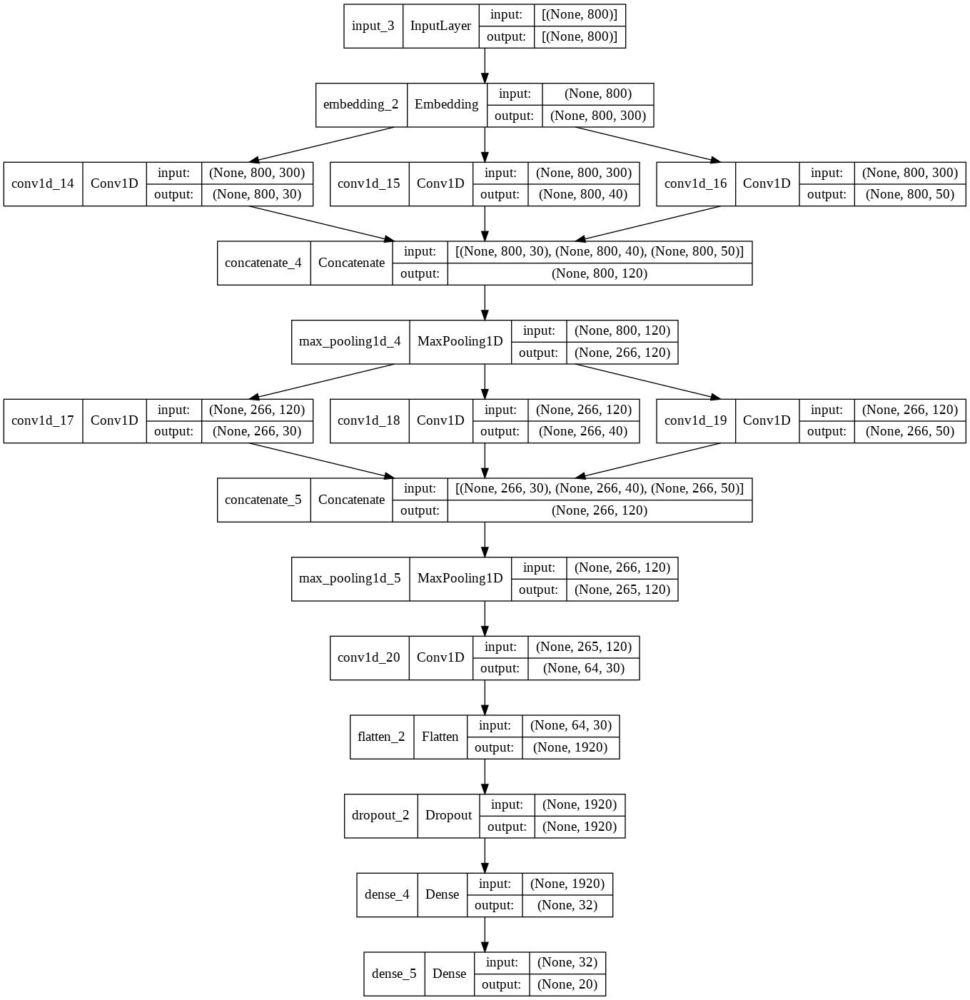

In [ ]:
#plot model
from tensorflow.keras.utils import plot_model
plot_model(model, to_file='model1_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
#model archietecture summary
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 800)]        0           []                               
                                                                                                  
 embedding_2 (Embedding)        (None, 800, 300)     25062600    ['input_3[0][0]']                
                                                                                                  
 conv1d_14 (Conv1D)             (None, 800, 30)      90030       ['embedding_2[0][0]']            
                                                                                                  
 conv1d_15 (Conv1D)             (None, 800, 40)      156040      ['embedding_2[0][0]']            
                                                                                            

### Model-2 : Using 1D convolutions with character embedding

# ***Model 2***

***Similar steps are followed like in Model1 but instead of word embeddings we have taken char embeddings and expressed each document as sequence of chars.***

In [ ]:
#char embeedings file is taken from link given above
import numpy as np
embeddings_index = dict()
f = open('/content/glove.840B.300d-char.txt')
for line in f:
	values = line.split()
	word = values[0]
	coefs = np.asarray(values[1:], dtype='float32')
	embeddings_index[word] = coefs
f.close()
print('Loaded %s word vectors.' % len(embeddings_index))

Loaded 94 word vectors.


In [ ]:
#dictionary of chars and their corresponding 300d embeddings
chars=list(embeddings_index.keys())
print(chars)
print(len(embeddings_index['a']))

['$', '(', ',', '0', '4', '8', '<', '@', 'D', 'H', 'L', 'P', 'T', 'X', '\\', '`', 'd', 'h', 'l', 'p', 't', 'x', '|', '#', "'", '+', '/', '3', '7', ';', '?', 'C', 'G', 'K', 'O', 'S', 'W', '[', '_', 'c', 'g', 'k', 'o', 's', 'w', '{', '"', '&', '*', '.', '2', '6', ':', '>', 'B', 'F', 'J', 'N', 'R', 'V', 'Z', '^', 'b', 'f', 'j', 'n', 'r', 'v', 'z', '~', '!', '%', ')', '-', '1', '5', '9', '=', 'A', 'E', 'I', 'M', 'Q', 'U', 'Y', ']', 'a', 'e', 'i', 'm', 'q', 'u', 'y', '}']
300


In [ ]:
#Tokenizing and getting the train sequences
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
#oov_token = '<UNK>'
filters='!"#$%&()*+,-./:;<=>?@[\\]^`{|}~\t\n'
pad_type = 'post'
tokenizer = Tokenizer(filters=filters,char_level=True)
tokenizer.fit_on_texts(list_of_preprocessed)
word_index = tokenizer.word_index
train_sequences = tokenizer.texts_to_sequences(list_of_preprocessed)
vocab_size = len(word_index) + 1

In [ ]:
test_sequences=tokenizer.texts_to_sequences(X_test_preprocessed)

In [ ]:
print(len(train_sequences[1]))

487


In [ ]:
#pad documents to a max length of 1014 chars
max_length = 1014
padded_docs = pad_sequences(train_sequences, maxlen=max_length, padding='post')
print(len(padded_docs[1]))

1014


In [ ]:
padded_docs_test = pad_sequences(test_sequences, maxlen=max_length, padding='post')
print(len(padded_docs_test[1]))

1014


In [ ]:
#getting the embedding matrix for embedding layer
import numpy as np
embedding_matrix=np.zeros((vocab_size,300))
for word,i in tokenizer.word_index.items():
  if word in chars:
    embedding_vector=embeddings_index[word]
    if embedding_vector is not None:
      embedding_matrix[i]=embedding_vector

In [ ]:
#import
from tensorflow.keras import Sequential

In [ ]:
#Model Archietecture
model = Sequential()
model.add(Embedding(vocab_size,300,weights=[embedding_matrix],input_length=1014,input_shape=(1014,)))
model.add(Conv1D(30, 10, activation='relu',padding='valid'))
model.add(Conv1D(40, 13, activation='relu',padding='valid'))
model.add(MaxPool1D(pool_size=3, strides=None, padding='valid'))
model.add(Conv1D(30, 10, activation='relu',padding='valid'))
model.add(Conv1D(40, 13, activation='relu',padding='valid'))
model.add(MaxPool1D(pool_size=3, strides=None, padding='valid'))
model.add(Flatten())
model.add(Dropout(0.2))
model.add(Dense(32,activation='relu'))
model.add(Dense(20, activation='softmax'))

In [ ]:
#Model compilation and fitting
model.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['accuracy',F1])
model.fit(padded_docs,y_categorical_train,batch_size=30,epochs=10,validation_data=(padded_docs_test,y_categorical_test),callbacks=[checkpoint,earlystop,TerminateOnNaN(),tensorboard_callback,reduce_lr],verbose=1)

Epoch 1/10
471/471 [==============================] - ETA: 0s - loss: 2.9828 - accuracy: 0.0703 - f1_score: 0.0703
Epoch 00001: val_accuracy improved from -inf to 0.07478, saving model to model_save/best_model_2.h5
471/471 [==============================] - 399s 843ms/step - loss: 2.9828 - accuracy: 0.0703 - f1_score: 0.0703 - val_loss: 2.9704 - val_accuracy: 0.0748 - val_f1_score: 0.0748 - lr: 0.0010
Epoch 2/10
471/471 [==============================] - ETA: 0s - loss: 2.9586 - accuracy: 0.0795 - f1_score: 0.0795
Epoch 00002: val_accuracy improved from 0.07478 to 0.07733, saving model to model_save/best_model_2.h5
471/471 [==============================] - 383s 813ms/step - loss: 2.9586 - accuracy: 0.0795 - f1_score: 0.0795 - val_loss: 2.9532 - val_accuracy: 0.0773 - val_f1_score: 0.0773 - lr: 0.0010
Epoch 3/10
471/471 [==============================] - ETA: 0s - loss: 2.9240 - accuracy: 0.0879 - f1_score: 0.0879
Epoch 00003: val_accuracy improved from 0.07733 to 0.09369, saving model

In [ ]:
#tensorboard plots
%tensorboard --logdir logs/fits

<IPython.core.display.Javascript object>

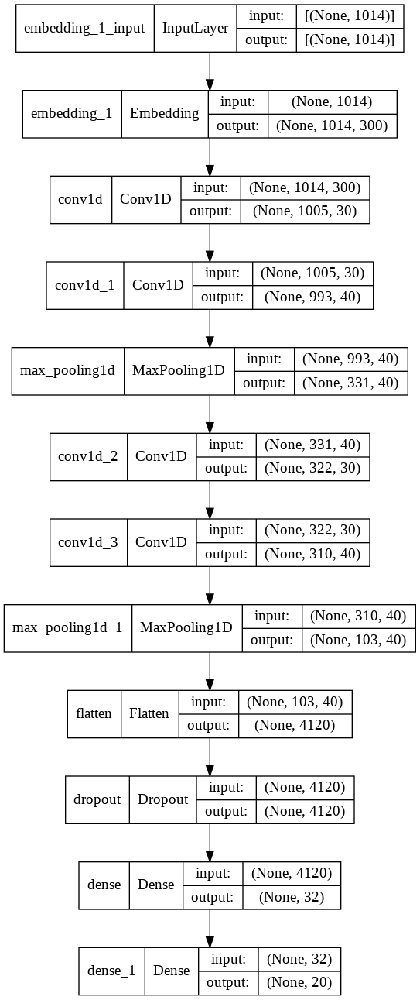

In [ ]:
#Plot model
from tensorflow.keras.utils import plot_model
plot_model(model, to_file='model2_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
#Model summary
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_1 (Embedding)     (None, 1014, 300)         13800     
                                                                 
 conv1d (Conv1D)             (None, 1005, 30)          90030     
                                                                 
 conv1d_1 (Conv1D)           (None, 993, 40)           15640     
                                                                 
 max_pooling1d (MaxPooling1D  (None, 331, 40)          0         
 )                                                               
                                                                 
 conv1d_2 (Conv1D)           (None, 322, 30)           12030     
                                                                 
 conv1d_3 (Conv1D)           (None, 310, 40)           15640     
                                                      

***Obeservations for Model1 and Model2:***


1. In the model1 we have used word embeddings which means converting each word to a 300 dimensional vector and in Model2 we have used char embedding which means converting each char into a 300 dimensional vector. This work is done by our Embedding layer.
2. Both in Model1 and Model2 conv1d is used and this is mostly used for text classification and the filter moves moves only in 1dimension and usage of more filters has helped in capturing more structure in our text data
3. In model1, padding same is used because of concatenation layers and there is no necessity of same padding in model2 and hence avoided to reduce the complexity with dimensions and also number of trainable parameters
4. Both in model1 and model2 the output layer has 20 neurons because we have 20 classes
5. In model1 the highest validation accuracy achieved is 0.8354
6. In model2 highest validation accuracy achieved is 0.1235
7. Both the models have been run for only 10 epochs
8. Max pool layer reduced the dimensionality in both models
9. Finally we can see that we can run for few more epochs to get better results
10. Usage of conv layers does give good results for NLP problems
